# Plotting

<div>
    <img style='width: 220px;height: 100px;float: left;' src="./Supplementary_data/EODC-Logo-Final.png" height='100px' width='220px'/>
    <img style='width: 200px;height: 100px;float: left;' src="./Supplementary_data/BMNT_DE_Logo_dreizeilig_srgb.svg" height='100px' width='200px'/> 
    <img style='width: 200px;height: 100px;float: left;' src="./Supplementary_data/bmlv.svg" height='100px' width='200px'/>
    <img style='width: 200px;height: 100px;float: left;' src="./Supplementary_data/LOGO_TUW_GEO.png" height='100px' width='200px'/>
    <img style='width: 100px;height: 100px;float: left;' src="./Supplementary_data/Boku-wien.svg" height='100px' width='100px'/>
    <img style='width: 150px;height: 100px;float: right;' src="./Supplementary_data/ADC_Logo_final_transparent.png" height='100px' width='150px'/>
</div>

This notebook shows how to create different kinds of plots using the ACube data. The libraries for creating plots can be a great tool for analysis of certain values and for decision making.

## Imports and setup

In [1]:
import datacube
import xarray
%matplotlib inline
acube = datacube.Datacube(app='sample_3', env='acube')

## Image plot

In this example we load the Monhly FAPAR calculated from Sentinel-2 imagery. This product contains a single measurement called `band_1` which we shall display.

To plot a single image the `xarray.Dataset` needs to be converted to an `xarray.DataArray`. This can be done either by:
* selecting the measurement
* using the `to_array` function

For now we will select the `band_1` measurement for the `MFAPAR_Sentinel_2` product.

To create a plot we use the `plot` function which, in this case, takes several arguments:
* `x` and `y` - coordinate axis
* `col` - the column for the values
* `size` - size of the plot
* `cmap` - the color map for the plot, A full list of colormaps can be found [here](https://matplotlib.org/3.2.0/tutorials/colors/colormaps.html "Choosing Colormaps in Matplotlib")
* `vmax` and `vmin` - value limits for the plot

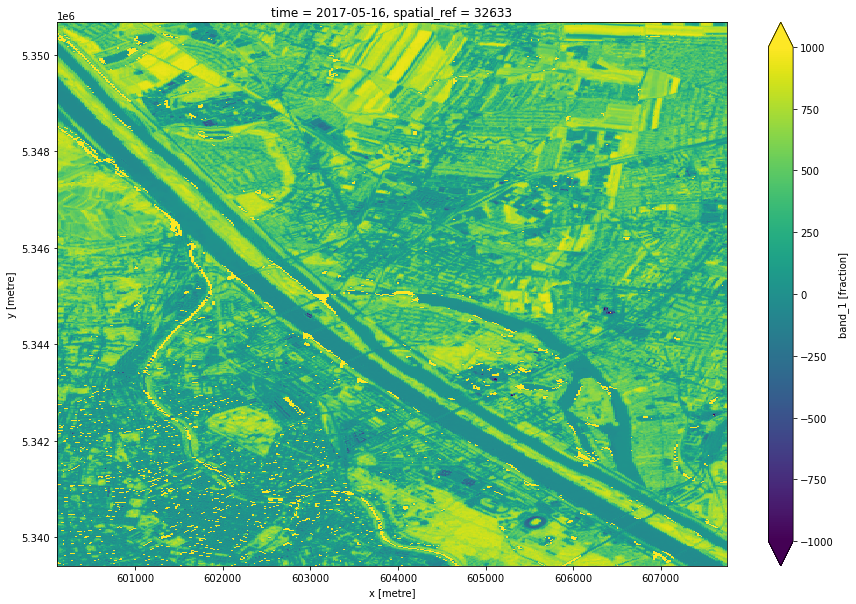

In [2]:
query_product = 'MFAPAR_Sentinel_2'
query_spatiotemporal = {
    'lon': (16.35, 16.45),
    'lat': (48.2, 48.3),
    'time': ('2017-05-01', '2017-05-31')
}
data = acube.load(product=query_product, output_crs='EPSG:32633', resolution=(-10, 10), **query_spatiotemporal)
data_plot = data.band_1
data_plot.plot(size=10, cmap='viridis', vmax=1000, vmin=-1000)

## Multi-band (RGB) plot

In this example we load the B product and mesaurements `B02`, `B03`, `B04`. Since this data has been scaled, we will clear `fake_saturation` values over 2000. In this example we use the `to_array` function to convert the `xarray.Dataset` into `xarray.DataArray`.

Additionally we use the `col_wrap` to display 2 images per line in the plot. Since this plot has multiple dimensions and acquisitions we have to use the `plot.imshow()` function.

Inspecting the plot, we can see that there are a lot of fully black (nodata) images. This means that there are datasets on these dates near the queried area, but they do not contain any data.

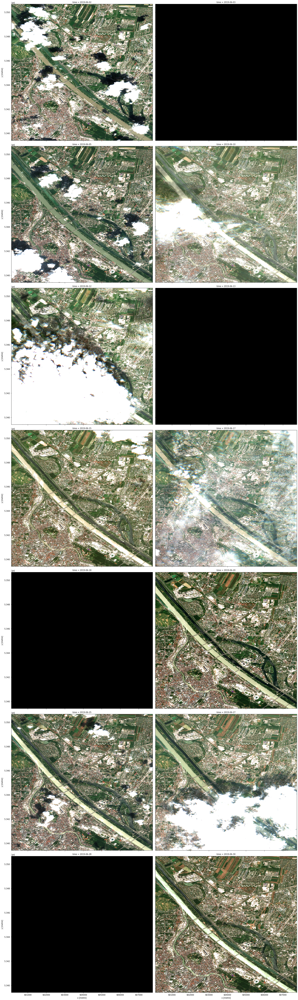

In [3]:
query_product = 'B_Sentinel_2'
query_spatiotemporal = {
    'lon': (16.35, 16.45),
    'lat': (48.2, 48.3),
    'time': ('2019-06-01', '2019-06-30')
}
data = acube.load(product=query_product, output_crs='EPSG:32633', measurements=['B04', 'B03', 'B02'], resolution=(-10, 10), **query_spatiotemporal)
data_plot = data.to_array(dim='color')
fake_saturation = 2000
data_plot = data_plot.transpose(*(data_plot.dims[1:]+data_plot.dims[:1]))
data_plot = data_plot.where((data_plot <= fake_saturation).all(dim='color'))
data_plot /= fake_saturation
data_plot.plot.imshow(
    x='x', 
    y='y',
    col='time',
    size=10,
    col_wrap=2,
)

It is posible to subset some values given their dates or indexes. The code below selects the two slices:
* 2019-06-20
* 2019-06-30

The rest is the same saturation and plotting as above.

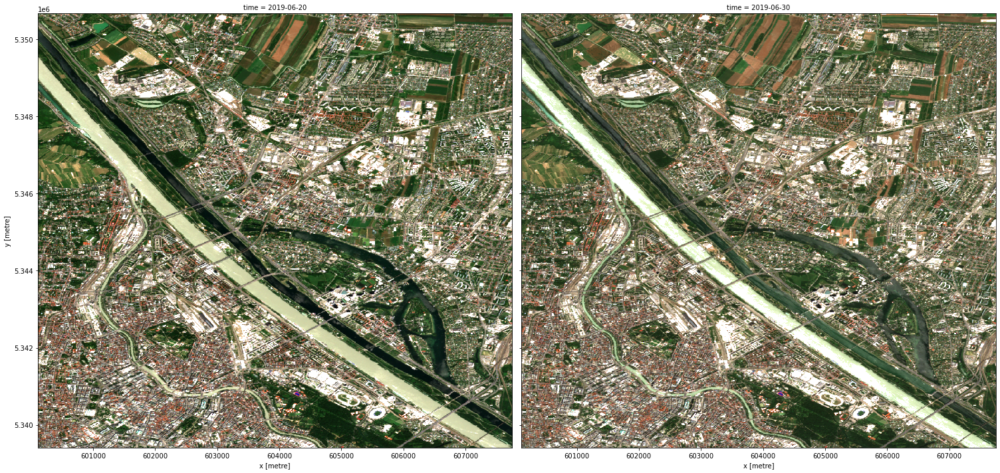

In [4]:
datasets = []
teporal_data = ['2019-06-20', '2019-06-30']
for time in teporal_data:
    datasets.append(data.sel(time=time))
new_data = xarray.concat([dataset for dataset in datasets], dim='time')
new_data_plot = new_data.to_array(dim='color')
fake_saturation = 2000
new_data_plot = new_data_plot.transpose(*(new_data_plot.dims[1:]+new_data_plot.dims[:1]))
new_data_plot = new_data_plot.where((new_data_plot <= fake_saturation).all(dim='color'))
new_data_plot /= fake_saturation
new_data_plot.plot.imshow(
    x='x', 
    y='y',
    col='time',
    size=10,
    col_wrap=2
)

## Histogram

This example shows how to plot a histogram. For this example we shall use Sentinel-1 SIG0 data. To invoke a histogram we simply call the `plot.hist()` function on the `xarray.DataArray`

In [5]:
query_product = 'GMR_Sentinel_1'
query_spatiotemporal = {
    'lon': (16.35, 16.45),
    'lat': (48.2, 48.3),
    'time': ('2019-06-01', '2019-06-30')
}
data = acube.load(product=query_product, 
               measurements=['VV', 'VH'], 
               output_crs='EPSG:32633', 
               resolution=(-10,10),
                **query_spatiotemporal)
data_plot_vh = data.VH
data_plot_vv = data.VV

(array([4.301320e+06, 0.000000e+00, 0.000000e+00, 0.000000e+00,
        2.660000e+02, 3.529480e+05, 6.058998e+06, 2.137599e+06,
        5.208700e+04, 7.420000e+02]),
 array([-9999. , -8714.3, -7429.6, -6144.9, -4860.2, -3575.5, -2290.8,
        -1006.1,   278.6,  1563.3,  2848. ]),
 <BarContainer object of 10 artists>)

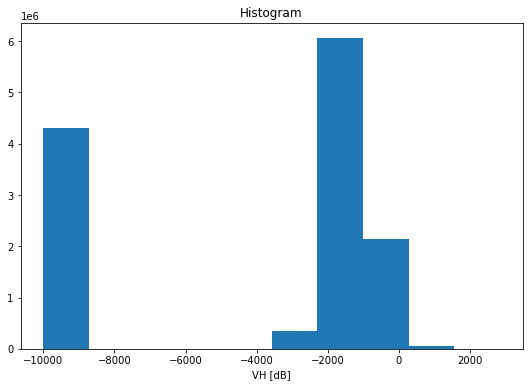

In [6]:
data_plot_vh.plot.hist(size=6)

(array([4.301320e+06, 0.000000e+00, 0.000000e+00, 0.000000e+00,
        7.810000e+02, 6.255790e+05, 6.676000e+06, 1.280066e+06,
        1.993700e+04, 2.770000e+02]),
 array([-9999. , -8573.5, -7148. , -5722.5, -4297. , -2871.5, -1446. ,
          -20.5,  1405. ,  2830.5,  4256. ]),
 <BarContainer object of 10 artists>)

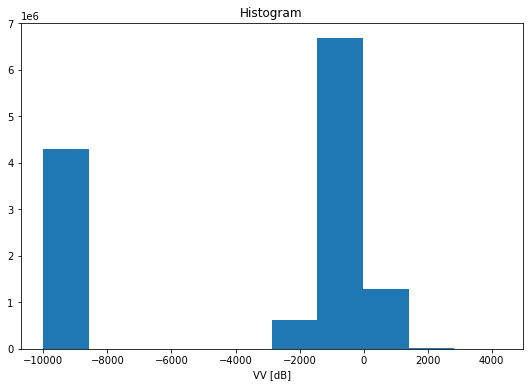

In [7]:
data_plot_vv.plot.hist(size=6)

## Pixel drill - Temporal line plot

In this example we will load the sufrace soil moisture product and plot how the soilmoisture changes over time. For this we use the `where` to subset only the data that have values, and `sel` that selects the nearest (or different `method` provided) pixel to the given point.

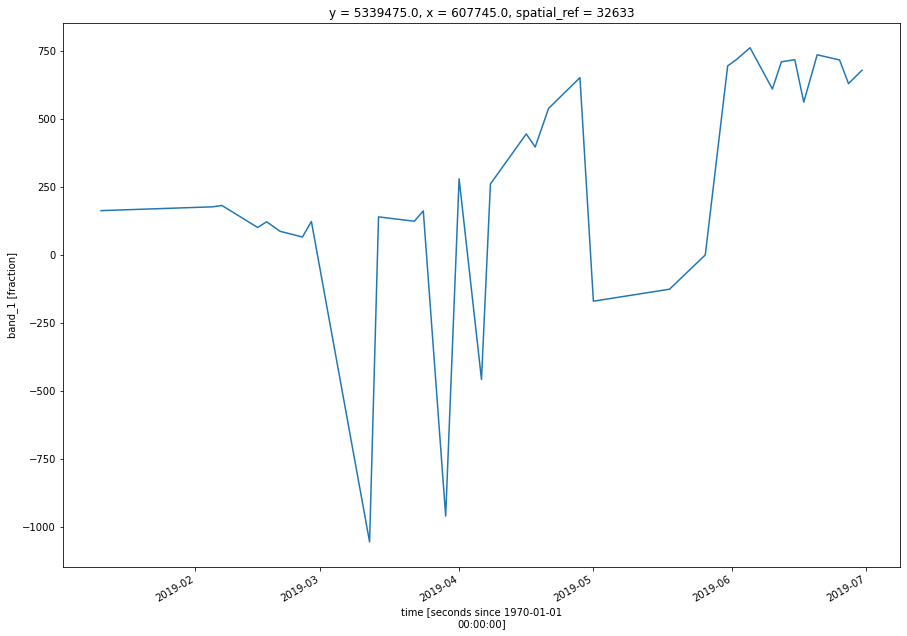

In [8]:
query_product = 'FAPAR_Sentinel_2'
query_spatiotemporal = {
    'lon': (16.4, 16.45),
    'lat': (48.2, 48.25),
    'time': ('2019-01-01', '2019-06-30')
}
data = acube.load(product=query_product,  
               output_crs='EPSG:32633', 
               resolution=(-10,10),
                **query_spatiotemporal)
data_plot = data.band_1
data_plot = data_plot.where(data.band_1 != data.band_1.attrs['nodata']).dropna(dim='time')
selection = data_plot.sel(y=605000, x=5340000, method='nearest')
selection.plot(size=10)

## Interactive geographic plot

The library `bokeh` provides an option to create interactive plots and embed them in a notebook. The code below creates an interactive map preview over Austria. The idea is to use the axis for lat and lon queries.

In [10]:
from bokeh.plotting import figure, show, output_notebook
from bokeh.tile_providers import CARTODBPOSITRON, get_provider
output_notebook()

# range bounds supplied in web mercator coordinates
p = figure(x_range=(1035200, 1933200), y_range=(5750600, 6376100),
           x_axis_type="mercator", y_axis_type="mercator", tools='pan, wheel_zoom, reset', active_scroll='wheel_zoom')
tile_provider = get_provider(CARTODBPOSITRON)
p.add_tile(tile_provider)

show(p)

Loading BokehJS ...